In [2]:
# start here only if the dataset is uploaded on drive
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# import zipfile
# import os

# zip_path = "/content/drive/MyDrive/archive.zip"
# extract_dir = "/content/"

# with zipfile.ZipFile(zip_path, 'r') as zip_ref:
#     zip_ref.extractall(extract_dir)

# print("Extraction complete!")

Extraction complete!


In [23]:
# start here if the dataset is already uploaded to session storage

import zipfile
import os

zip_path = "/content/archive.zip"
extract_dir = "/content/"

# Check if the zip file exists
if os.path.exists(zip_path):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_dir)
    print("Extraction complete!")
else:
    print("archive.zip not found in /content/. Please upload it first.")


archive.zip not found in /content/. Please upload it first.


In [24]:
import json
import os
from collections import defaultdict

with open('/content/ImageClassesCombinedWithCOCOAnnotations/coco_instances.json') as f:
    coco_data = json.load(f)

# for item in coco_data['categories']:
#     print(item['id'], item['name'])

images = coco_data['images']
images = sorted(images, key=lambda x: x['id'])

annotations = coco_data['annotations']
annotations = sorted(annotations, key=lambda x: x['image_id'])

# print(annotations)

image_id_to_annotations = defaultdict(list)
for ann in annotations:
    image_id_to_annotations[ann['image_id']].append(ann)

for image in images:
    image['annotations'] = image_id_to_annotations.get(image['id'], [])

# width and height are (300X300)

for image in images:
    del image['width']
    del image['height']
    del image['license']

for image in images:
  for annotation in image['annotations']:
    for category in coco_data['categories']:
        if annotation['category_id'] == category['id']:
            annotation['category_name'] = category['name']
    del annotation['category_id']
    del annotation['image_id']
    del annotation['id']
    del annotation['iscrowd']

# print(images)

print(images[2])

print("total: ", len(images))


{'file_name': '00000002.jpg', 'id': 2, 'annotations': [{'segmentation': [[123.0, 128.5, 121.0, 125.5, 116.0, 125.5, 112.0, 128.5, 91.0, 127.5, 89.5, 126.0, 89.5, 122.0, 94.5, 121.0, 93.0, 117.5, 69.0, 112.5, 67.5, 111.0, 67.5, 107.0, 77.0, 100.5, 87.0, 98.5, 94.0, 102.5, 119.0, 110.5, 137.0, 111.5, 149.5, 104.0, 155.5, 93.0, 156.5, 88.0, 159.0, 87.5, 159.5, 91.0, 155.5, 102.0, 148.0, 109.5, 138.0, 114.5, 125.5, 124.0, 129.0, 126.5, 125.0, 125.5, 123.0, 128.5], [157.0, 173.5, 155.5, 173.0, 169.5, 158.0, 166.0, 154.5, 163.5, 156.0, 163.5, 158.0, 165.5, 159.0, 160.0, 161.5, 158.5, 166.0, 155.0, 168.5, 156.5, 164.0, 154.0, 162.5, 141.0, 161.5, 138.5, 160.0, 138.0, 157.5, 128.0, 157.5, 111.0, 154.5, 105.5, 149.0, 104.5, 145.0, 120.0, 133.5, 127.0, 132.5, 129.0, 134.5, 171.0, 135.5, 187.0, 132.5, 206.5, 119.0, 210.5, 111.0, 210.5, 98.0, 212.0, 96.5, 214.5, 99.0, 214.5, 111.0, 210.5, 120.0, 179.5, 151.0, 190.5, 162.0, 190.5, 164.0, 185.0, 159.5, 184.0, 160.5, 183.5, 158.0, 178.0, 153.5, 174.5

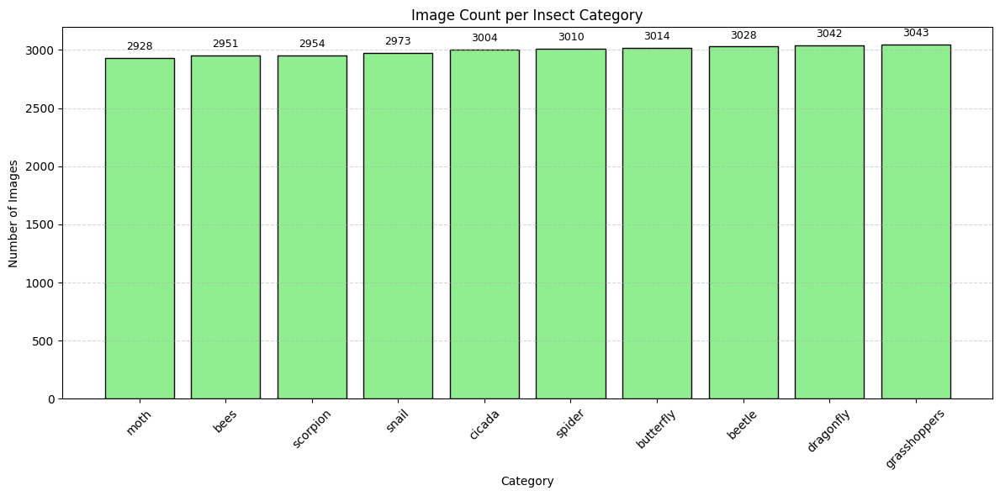

total:  29947


In [6]:
from collections import defaultdict
import copy
import matplotlib as plt

category_to_images = defaultdict(list)

for image in images:
    for annotation in image['annotations']:
        new_image = {
            'file_name': image['file_name'],
            'id': image['id'],
            'annotations': [copy.deepcopy(annotation)]
        }
        category_name = annotation['category_name']
        category_to_images[category_name].append(new_image)

def calcTotalInsects(category_to_images):
    total = 0
    for category, imgs in category_to_images.items():
        # print(f"{category}: {len(imgs)} images")
        total += len(imgs)

    return total

def visulaizeInsectsPerCategory(category_to_images):
  import matplotlib.pyplot as plt

  categories = list(category_to_images.keys())
  image_counts = [len(images) for images in category_to_images.values()]

  sorted_pairs = sorted(zip(categories, image_counts), key=lambda x: x[1])
  categories, image_counts = zip(*sorted_pairs)

  plt.figure(figsize=(12, 6))
  bars = plt.bar(categories, image_counts, color='lightgreen', edgecolor='black')

  for bar, count in zip(bars, image_counts):
      yval = bar.get_height()
      plt.text(bar.get_x() + bar.get_width()/2.0, yval + 50, str(count), ha='center', va='bottom', fontsize=9)

  plt.title('Image Count per Insect Category')
  plt.xlabel('Category')
  plt.ylabel('Number of Images')
  plt.xticks(rotation=45)
  plt.tight_layout()
  plt.grid(axis='y', linestyle='--', alpha=0.5)
  plt.show()


visulaizeInsectsPerCategory(category_to_images)
print("total: ", calcTotalInsects(category_to_images))


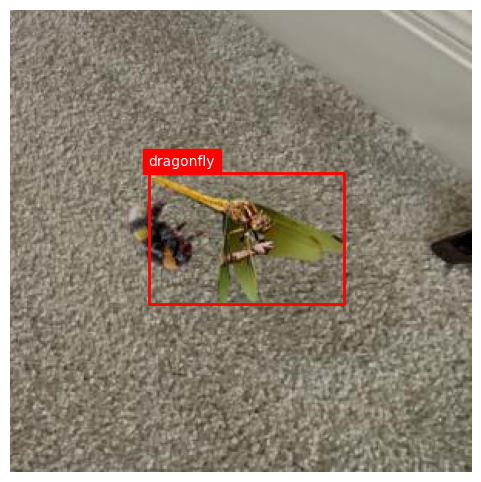

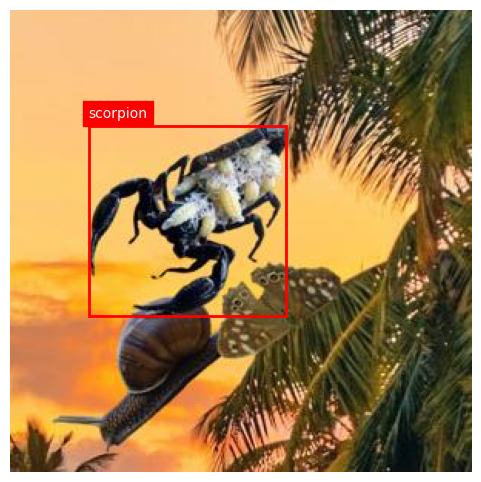

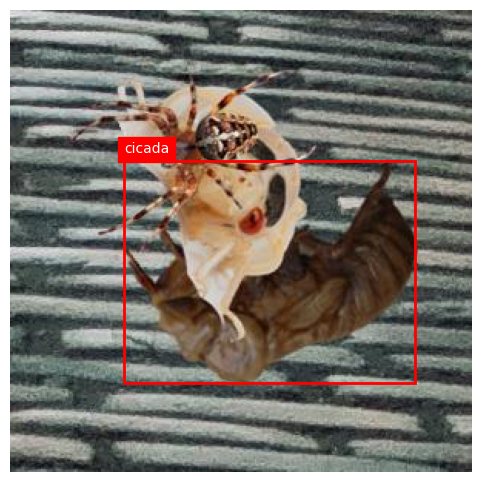

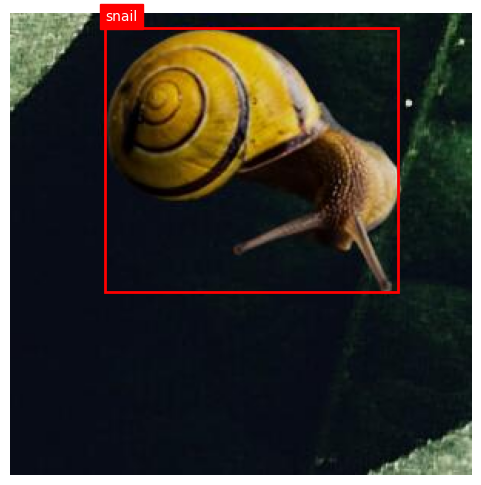

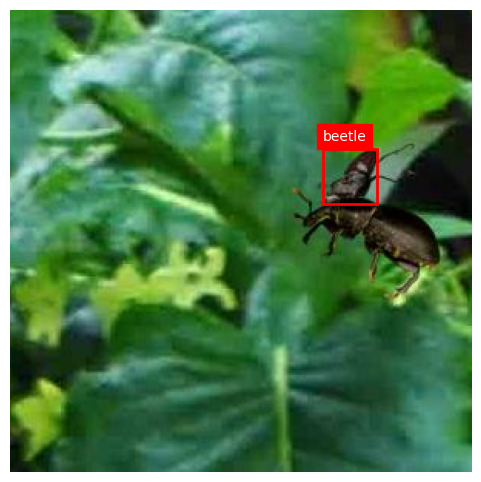

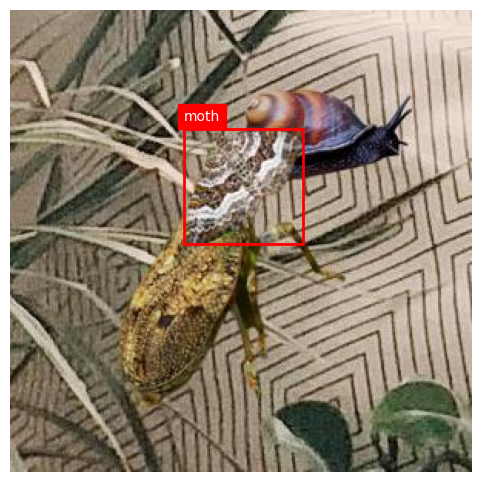

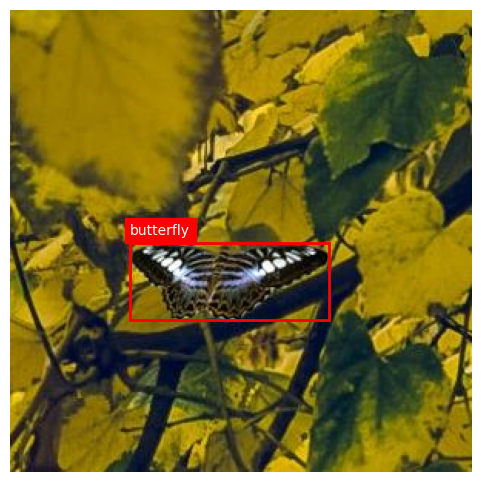

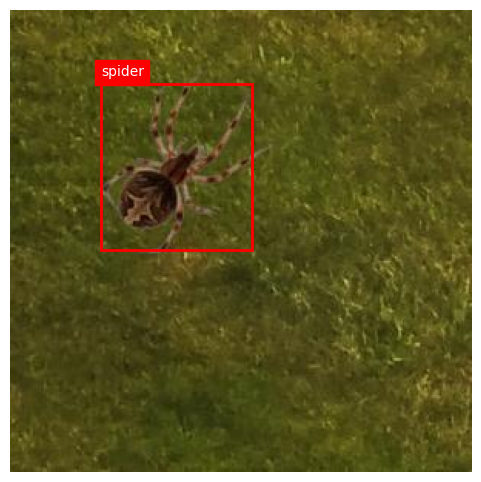

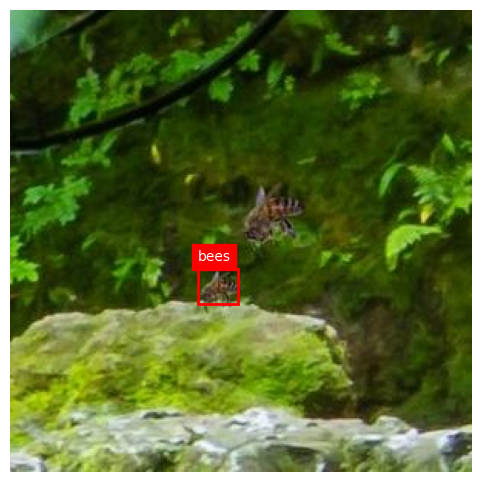

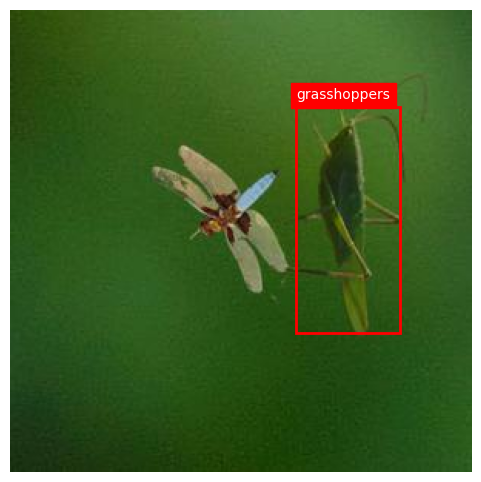

In [7]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np

def show_annotated_image(image_data):
    file_path = os.path.join('/content/ImageClassesCombinedWithCOCOAnnotations/images_raw', image_data['file_name'])

    try:
        img = Image.open(file_path).convert("RGB")
    except FileNotFoundError:
        print(f"Image not found: {file_path}")
        return

    fig, ax = plt.subplots(figsize=(6, 6))
    ax.imshow(img)

    for ann in image_data['annotations']:
        x, y, w, h = ann['bbox']
        rect = patches.Rectangle((x, y), w, h, linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        ax.text(x, y - 5, ann['category_name'], color='white', backgroundcolor='red', fontsize=10)

    ax.axis('off')
    plt.show()

for key in category_to_images.keys():
    show_annotated_image(category_to_images[key][np.random.randint(0, len(category_to_images[key]))])



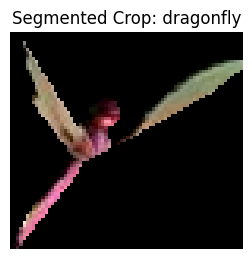

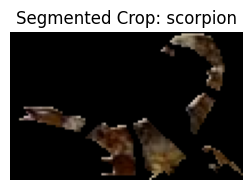

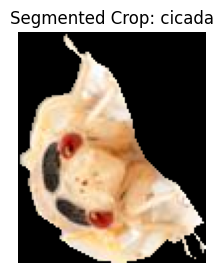

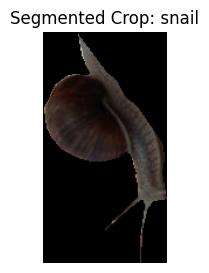

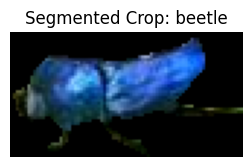

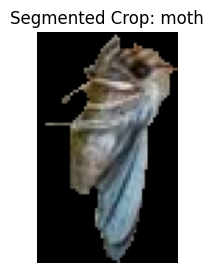

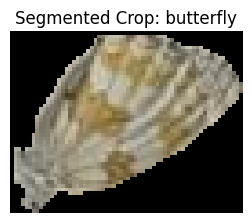

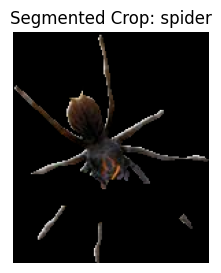

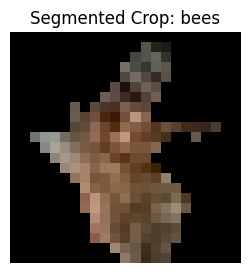

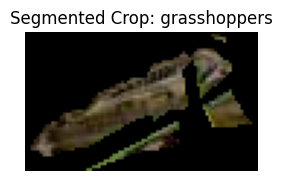

In [8]:
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
import os

from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import os

def show_segmented_crop(image_data):
    # Use image_data['file_path'] if available, else use default path
    file_path = image_data.get('file_path', os.path.join(
        '/content/ImageClassesCombinedWithCOCOAnnotations/images_raw',
        image_data['file_name']
    ))

    try:
        img = Image.open(file_path).convert("RGB")
    except FileNotFoundError:
        print(f"Image not found: {file_path}")
        return

    if not image_data['annotations']:  # Check if there are no annotations
        # No annotations, just display the image as is
        plt.figure(figsize=(5, 5))
        plt.imshow(img)
        plt.title("Original Image (No Annotations)")
        plt.axis('off')
        plt.show()
        plt.close()
    else:
        # Loop through annotations and display segmented crop
        for ann in image_data['annotations']:
            mask = Image.new('L', img.size, 0)
            draw = ImageDraw.Draw(mask)

            if isinstance(ann['segmentation'], list):
                for seg in ann['segmentation']:
                    polygon = [(seg[i], seg[i + 1]) for i in range(0, len(seg), 2)]
                    draw.polygon(polygon, outline=1, fill=255)
            else:
                print(f"Unsupported segmentation format in image: {image_data['file_name']}")
                continue

            masked = Image.new('RGB', img.size)
            masked.paste(img, mask=mask)

            x, y, w, h = map(int, ann['bbox'])
            cropped = masked.crop((x, y, x + w, y + h))

            plt.figure(figsize=(3, 3))
            plt.imshow(cropped)
            plt.title(f"Segmented Crop: {ann['category_name']}")
            plt.axis('off')
            plt.show()
            plt.close()

for key in category_to_images.keys():
    show_segmented_crop(category_to_images[key][np.random.randint(0, len(category_to_images[key]))])

# print(category_to_images['ants'][np.random.randint(0, len(category_to_images['ants']))])


In [9]:
print(category_to_images['grasshoppers'][np.random.randint(0, len(category_to_images['bees']))])

{'file_name': '00005901.jpg', 'id': 5901, 'annotations': [{'segmentation': [[45.0, 126.5, 41.0, 124.5, 38.5, 120.0, 36.5, 109.0, 38.5, 103.0, 29.0, 99.5, 28.0, 101.5, 23.5, 101.0, 30.0, 97.5, 40.0, 100.5, 41.0, 98.5, 42.0, 100.5, 46.0, 101.5, 44.5, 98.0, 45.5, 96.0, 43.5, 93.0, 50.5, 90.0, 34.5, 67.0, 37.5, 67.0, 46.5, 81.0, 50.0, 83.5, 50.5, 81.0, 54.5, 77.0, 51.5, 74.0, 53.0, 72.5, 63.0, 70.5, 70.0, 63.5, 78.0, 59.5, 86.0, 59.5, 89.0, 56.5, 89.0, 60.5, 95.0, 59.5, 108.0, 47.5, 115.0, 47.5, 116.5, 49.0, 115.5, 56.0, 89.5, 87.0, 93.5, 96.0, 109.5, 118.0, 109.5, 123.0, 107.0, 125.5, 94.0, 112.5, 84.0, 106.5, 75.0, 103.5, 61.0, 117.5, 46.0, 124.5, 45.0, 126.5], [106.5, 119.0, 89.5, 92.0, 87.0, 90.5, 82.5, 95.0, 82.5, 97.0, 96.0, 111.5, 106.5, 119.0]], 'bbox': [23.5, 47.5, 93.0, 79.0], 'area': 3177.0, 'category_name': 'grasshoppers'}]}


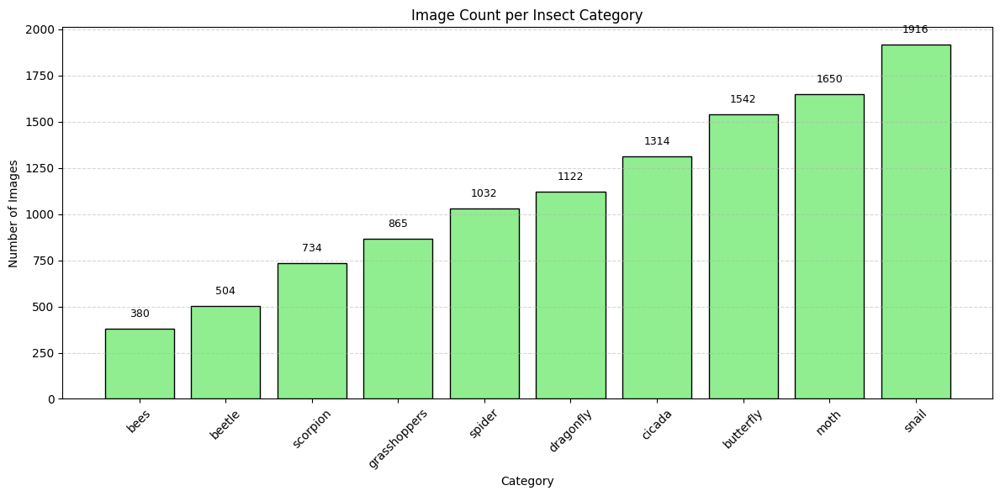

total:  11059


In [10]:
def is_large_enough(annotation, min_area=1000, min_width=50, min_height=50):
    bbox = annotation['bbox']
    area = annotation['area']
    return (
        area >= min_area and
        bbox[2] >= min_width and
        bbox[3] >= min_height
    )

def is_connected_segmentation(segmentation, bbox, img_size=(300, 300)):
    import numpy as np
    from PIL import Image, ImageDraw
    from scipy.ndimage import label

    """
    segmentation: list of polygon coordinates (COCO-style).
    bbox: [x, y, w, h] for cropping mask area.
    img_size: size of full canvas (adjust to your dataset).
    """
    mask = Image.new('L', img_size, 0)
    draw = ImageDraw.Draw(mask)

    for polygon in segmentation:
        coords = list(zip(polygon[::2], polygon[::1][1::2]))
        draw.polygon(coords, outline=1, fill=1)

    x, y, w, h = map(int, bbox)
    cropped = mask.crop((x, y, x + w, y + h))
    mask_np = np.array(cropped)

    labeled, num_features = label(mask_np)
    return num_features == 1

filtered_images = {}

for key, img_list in category_to_images.items():
    filtered_images[key] = []
    for img_dict in img_list:
        annotation = img_dict['annotations'][0]
        if is_large_enough(annotation) and is_connected_segmentation(annotation['segmentation'], annotation['bbox']):
            filtered_images[key].append(img_dict)

# for key in filtered_images.keys():
#     show_segmented_crop(filtered_images[key][np.random.randint(0, len(filtered_images[key]))])

visulaizeInsectsPerCategory(filtered_images)
print("total: ", calcTotalInsects(filtered_images))


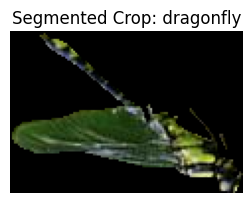

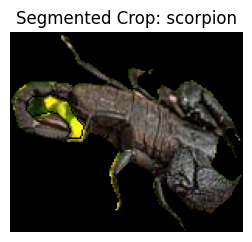

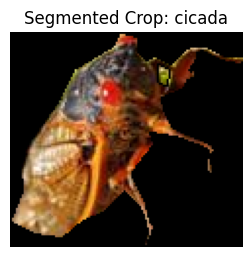

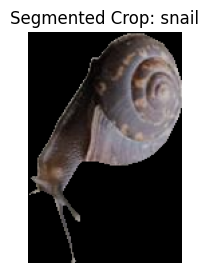

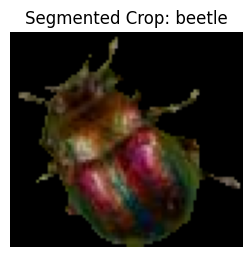

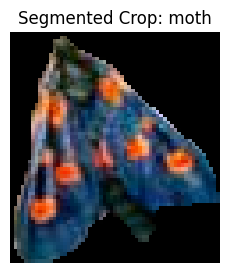

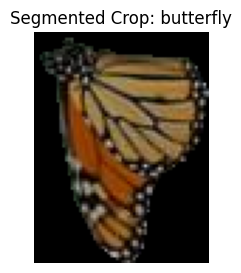

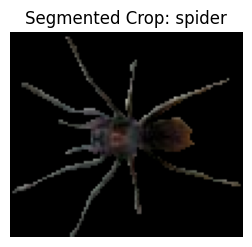

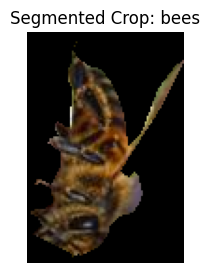

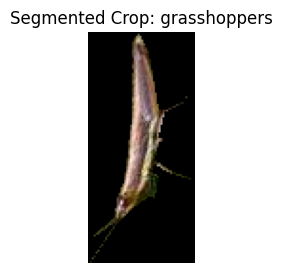

In [11]:
for key in filtered_images.keys():
    show_segmented_crop(filtered_images[key][np.random.randint(0, len(filtered_images[key]))])

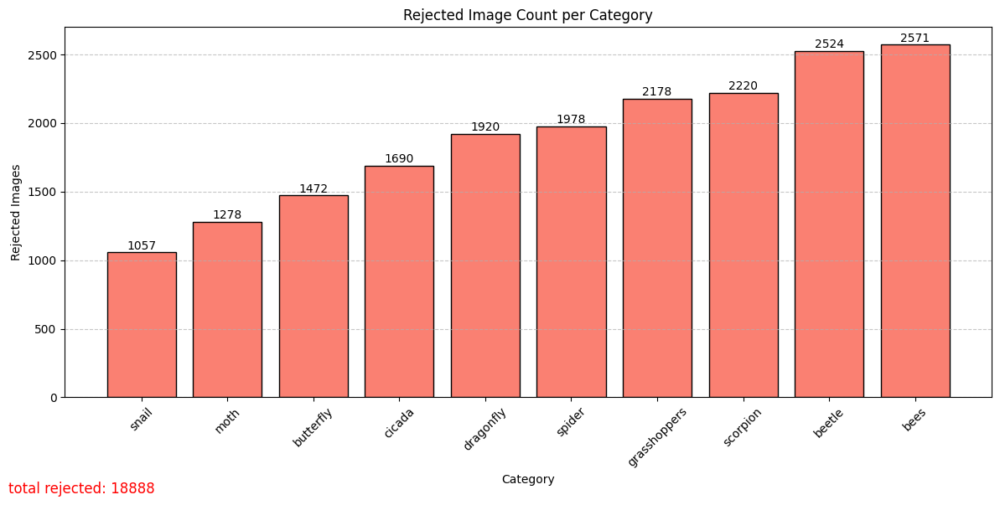

In [12]:
import matplotlib.pyplot as plt

def plot_rejected_samples(original, filtered):
    rejected_data = [
        (cat, len(original[cat]) - len(filtered.get(cat, [])))
        for cat in original.keys()
    ]
    rejected_data.sort(key=lambda x: x[1])

    categories, rejected_counts = zip(*rejected_data)

    plt.figure(figsize=(12, 6))
    bars = plt.bar(categories, rejected_counts, color='salmon', edgecolor='black')
    plt.xlabel("Category")
    plt.ylabel("Rejected Images")
    plt.title("Rejected Image Count per Category")
    plt.xticks(rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, height + 5, f'{height}', ha='center', va='bottom')

    total_rejected = sum(rejected_counts)
    plt.figtext(0.01, 0.01, f'total rejected: {total_rejected}', fontsize=12, color='red')

    plt.tight_layout()
    plt.show()

plot_rejected_samples(category_to_images, filtered_images)

bees


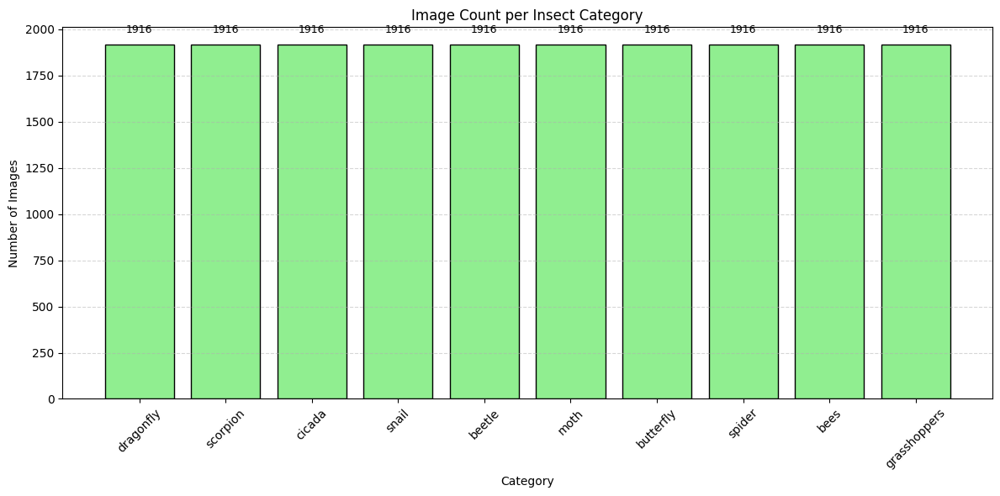

total:  19160


In [13]:
def oversample_images(filtered_images):
    import random
    max_count = max(len(imgs) for imgs in filtered_images.values())
    balanced = {}
    for category, imgs in filtered_images.items():
        if len(imgs) < max_count:
            repeats = max_count // len(imgs)
            remainder = max_count % len(imgs)
            balanced[category] = imgs * repeats + random.sample(imgs, remainder)
        else:
            balanced[category] = imgs
    return balanced

print(filtered_images['bees'][0]['annotations'][0]['category_name'])

import os
import random

def oversample_with_new_images(filtered_images, insects_folder, starting_id=100000):
    max_count = max(len(imgs) for imgs in filtered_images.values())
    balanced = {}
    next_id = starting_id

    for class_name, imgs in filtered_images.items():
        current_count = len(imgs)
        needed = max_count - current_count

        # Capitalize or adjust class_name to match folder naming
        class_folder = imgs[0]['annotations'][0]['category_name'].capitalize()
        if class_folder == 'Bee':
            class_folder = 'Bees'
        elif class_folder == 'Beetle':
            class_folder = 'Beetles'
        elif class_folder == 'Grasshoppers':
            class_folder = 'Grasshopper'

        class_dir = os.path.join(insects_folder, class_folder)

        all_file_names = [
            f for f in os.listdir(class_dir)
            if f.lower().endswith(('.jpg', '.jpeg', '.png'))
        ]

        used_file_names = set(img['file_name'] for img in imgs)
        candidates = [f for f in all_file_names if f not in used_file_names]

        if len(candidates) < needed:
            # Use repetition if not enough unique files
            additional_files = random.choices(all_file_names, k=needed)
        else:
            additional_files = random.sample(candidates, needed)

        new_image_entries = []
        for fname in additional_files:
            new_image_entries.append({
                'file_name': fname,
                'id': next_id,
                'annotations': [],
                'file_path': os.path.join(class_dir, fname)
            })
            next_id += 1

        balanced[class_name] = imgs + new_image_entries

    return balanced

balanced_images = oversample_with_new_images(filtered_images, '/content/Insect Classes/Insect Classes/', 1)
visulaizeInsectsPerCategory(balanced_images)
print("total: ", calcTotalInsects(balanced_images))

1916


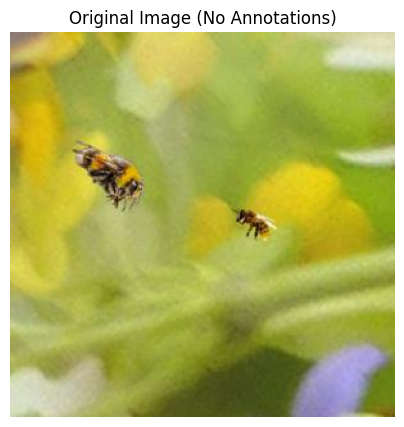

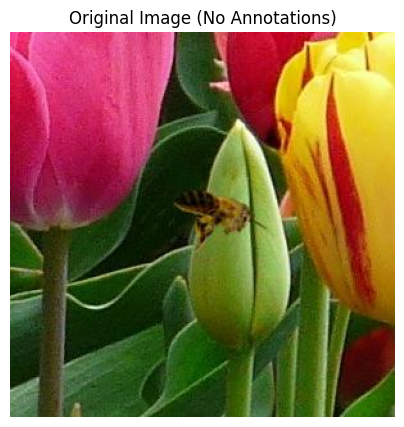

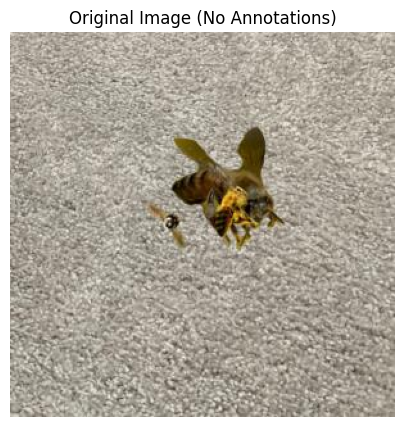

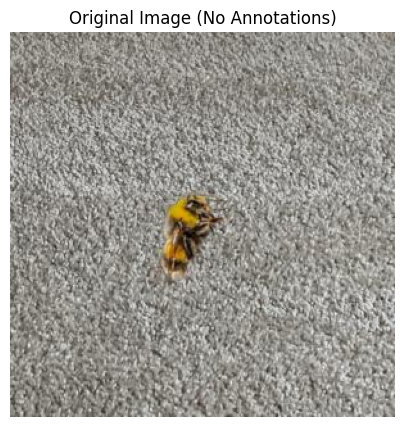

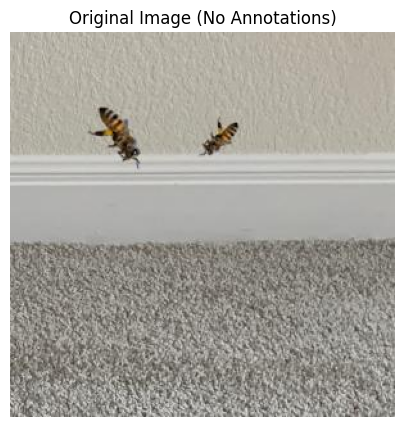

...

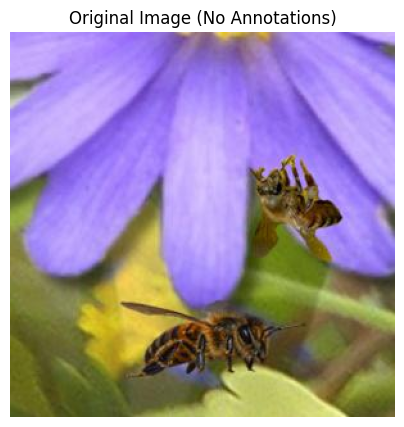

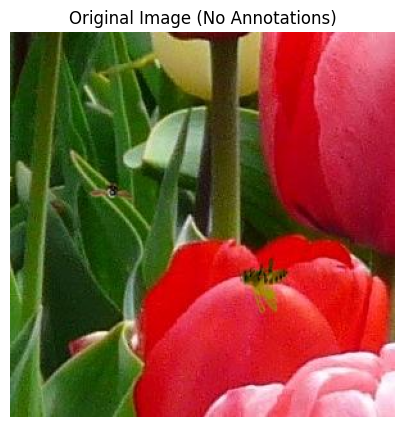

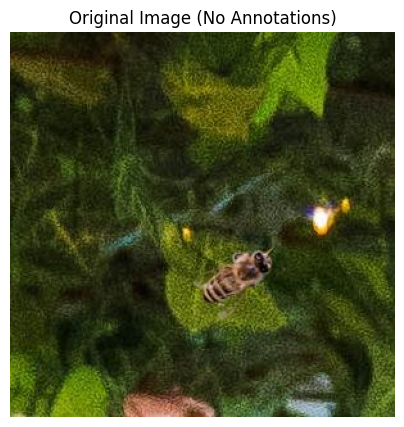

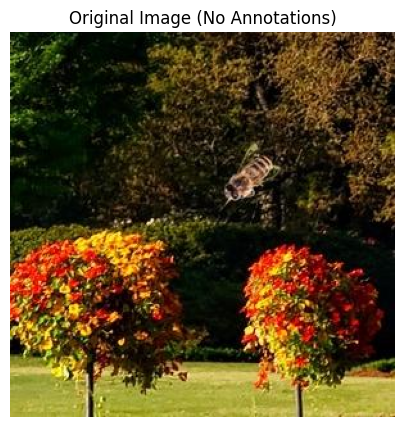

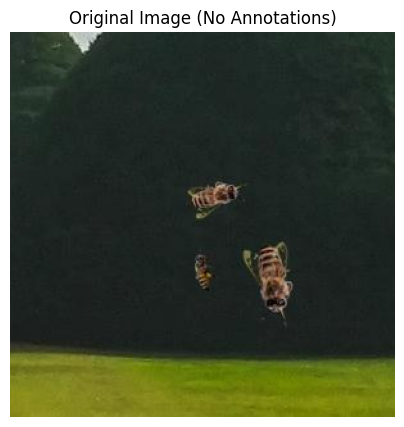

In [14]:
# for key in filtered_images.keys():
#     show_segmented_crop(balanced_images[key][np.random.randint(0, len(filtered_images[key]))])

print(len(balanced_images['bees']))

for i in range(500, 550):
    show_segmented_crop(balanced_images['bees'][i])

In [15]:
import os
from PIL import Image, ImageDraw
import numpy as np

def resize_with_padding(image, target_size):
    width, height = image.size
    target_width, target_height = target_size

    scale = min(target_width / width, target_height / height)

    new_width = int(width * scale)
    new_height = int(height * scale)

    resized_image = image.resize((new_width, new_height), Image.Resampling.LANCZOS)

    new_image = Image.new("RGB", target_size, (0, 0, 0))
    new_image.paste(resized_image, ((target_width - new_width) // 2, (target_height - new_height) // 2))

    return new_image

def save_segmented_images(balanced_images, base_path, output_dir, img_size=(224, 224)):
    os.makedirs(output_dir, exist_ok=True)

    for class_name, entries in balanced_images.items():
        class_dir = os.path.join(output_dir, class_name)
        os.makedirs(class_dir, exist_ok=True)

        for idx, entry in enumerate(entries):
            try:
                file_path = entry.get('file_path', os.path.join(base_path, entry['file_name']))
                img = Image.open(file_path).convert('RGB')

                # Check if annotations are present
                if not entry['annotations']:
                    # If no annotations, save the image as is
                    resized_img = resize_with_padding(img, img_size)
                    save_name = f"{os.path.splitext(entry['file_name'])[0]}_{idx}.jpg"
                    save_path = os.path.join(class_dir, save_name)
                    resized_img.save(save_path)
                    print(f"Saved {save_name} (no annotations)")
                else:
                    # Process with annotations
                    annotation = entry['annotations'][0]
                    segmentation = annotation['segmentation'][0]

                    mask_img = Image.new('L', img.size, 0)
                    polygon = [(segmentation[i], segmentation[i + 1]) for i in range(0, len(segmentation), 2)]
                    ImageDraw.Draw(mask_img).polygon(polygon, outline=1, fill=1)

                    mask = np.array(mask_img)
                    img_array = np.array(img)
                    masked_img_array = img_array * mask[:, :, np.newaxis]

                    ys, xs = np.where(mask)
                    if len(xs) == 0 or len(ys) == 0:
                        print(f"Empty mask for {entry['file_name']}, skipping...")
                        continue

                    x_min, x_max = xs.min(), xs.max()
                    y_min, y_max = ys.min(), ys.max()
                    cropped = masked_img_array[y_min:y_max+1, x_min:x_max+1]

                    cropped_img = Image.fromarray(cropped)
                    resized_img = resize_with_padding(cropped_img, img_size)

                    save_name = f"{os.path.splitext(entry['file_name'])[0]}_{idx}.jpg"
                    save_path = os.path.join(class_dir, save_name)
                    resized_img.save(save_path)

                    print(f"Saved {save_name}")

            except Exception as e:
                print(f"Error processing {entry['file_name']}: {e}")

base_path = "/content/ImageClassesCombinedWithCOCOAnnotations/images_raw"
output_dir = "/content/SegmentedDataset"
save_segmented_images(balanced_images, base_path, output_dir)

Streaming output truncated to the last 5000 lines.
Saved 00010906_748.jpg
Saved 00010930_749.jpg
Saved 00010961_750.jpg
Saved 00010970_751.jpg
Saved 00010989_752.jpg
Saved 00011014_753.jpg
Saved 00011053_754.jpg
Saved 00011071_755.jpg
Saved 00011085_756.jpg
Saved 00011124_757.jpg
Saved 00011133_758.jpg
Saved 00011149_759.jpg
Saved 00011151_760.jpg
Saved 00011155_761.jpg
Saved 00011158_762.jpg
Saved 00011183_763.jpg
Saved 00011183_764.jpg
Saved 00011188_765.jpg
Saved 00011211_766.jpg
Saved 00011216_767.jpg
Saved 00011226_768.jpg
Saved 00011245_769.jpg
Saved 00011247_770.jpg
Saved 00011249_771.jpg
Saved 00011269_772.jpg
Saved 00011292_773.jpg
Saved 00011305_774.jpg
Saved 00011316_775.jpg
Saved 00011317_776.jpg
Saved 00011345_777.jpg
Saved 00011374_778.jpg
Saved 00011386_779.jpg
Saved 00011391_780.jpg
Saved 00011416_781.jpg
Saved 00011418_782.jpg
Saved 00011506_783.jpg
Saved 00011507_784.jpg
Saved 00011508_785.jpg
Saved 00011509_786.jpg
Saved 00011510_787.jpg
Saved 00011516_788.jpg
Saved 

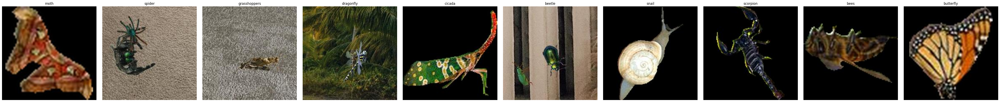

In [16]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt

def show_random_images_from_each_class(segmented_dataset_path):
    class_dirs = [d for d in os.listdir(segmented_dataset_path)
                  if os.path.isdir(os.path.join(segmented_dataset_path, d))]

    num_classes = len(class_dirs)
    fig, axs = plt.subplots(1, num_classes, figsize=(5 * num_classes, 5))

    if num_classes == 1:
        axs = [axs]

    for i, class_name in enumerate(class_dirs):
        class_path = os.path.join(segmented_dataset_path, class_name)
        images = os.listdir(class_path)
        if not images:
            print(f"No images in {class_name}")
            continue

        img_name = random.choice(images)
        img_path = os.path.join(class_path, img_name)

        try:
            img = Image.open(img_path)
            axs[i].imshow(img)
            axs[i].axis('off')
            axs[i].set_title(class_name)
        except Exception as e:
            print(f"Failed to load {img_path}: {e}")

    plt.tight_layout()
    plt.show()

segmented_dataset_path = "/content/SegmentedDataset"
show_random_images_from_each_class(segmented_dataset_path)

Found 13410 images belonging to 10 classes.
Found 2870 images belonging to 10 classes.
Found 2880 images belonging to 10 classes.
Class weights: {0: np.float64(1.0), 1: np.float64(1.0), 2: np.float64(1.0), 3: np.float64(1.0), 4: np.float64(1.0), 5: np.float64(1.0), 6: np.float64(1.0), 7: np.float64(1.0), 8: np.float64(1.0), 9: np.float64(1.0)}
9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/5


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


420/420 ━━━━━━━━━━━━━━━━━━━━ 44s 82ms/step - accuracy: 0.7321 - loss: 0.8350 - val_accuracy: 0.8840 - val_loss: 0.3659
Epoch 2/5
420/420 ━━━━━━━━━━━━━━━━━━━━ 25s 60ms/step - accuracy: 0.9106 - loss: 0.2829 - val_accuracy: 0.8631 - val_loss: 0.4346
Epoch 3/5
420/420 ━━━━━━━━━━━━━━━━━━━━ 23s 54ms/step - accuracy: 0.9285 - loss: 0.2243 - val_accuracy: 0.8892 - val_loss: 0.3414
Epoch 4/5
420/420 ━━━━━━━━━━━━━━━━━━━━ 21s 51ms/step - accuracy: 0.9474 - loss: 0.1669 - val_accuracy: 0.9077 - val_loss: 0.3004
Epoch 5/5
420/420 ━━━━━━━━━━━━━━━━━━━━ 24s 57ms/step - accuracy: 0.9645 - loss: 0.1129 - val_accuracy: 0.9056 - val_loss: 0.3166
90/90 ━━━━━━━━━━━━━━━━━━━━ 5s 51ms/step - accuracy: 0.8828 - loss: 0.4052
🧪 Test accuracy: 0.9052
🧪 Test loss:     0.3139


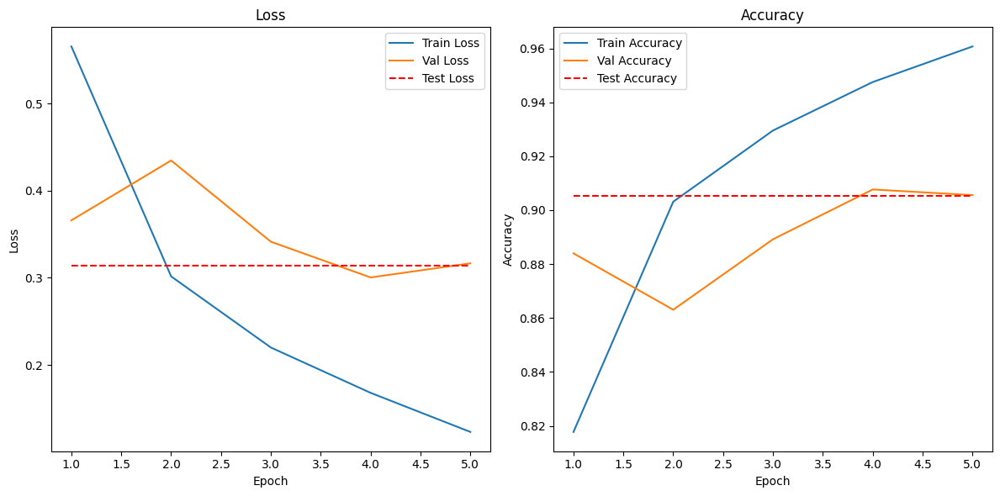

Model saved as 'insect_classifier_model_mobilenet.h5'


In [17]:
import os
import numpy as np
import tensorflow as tf
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image
import matplotlib.pyplot as plt
import shutil

# Paths
original_dir = '/content/SegmentedDataset'
base_dir = '/content/SegmentedDataset_Split'
train_dir = os.path.join(base_dir, 'train')
val_dir = os.path.join(base_dir, 'val')
test_dir = os.path.join(base_dir, 'test')

# Create split dirs
def split_dataset(original_dir, base_dir, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
    if os.path.exists(base_dir):
        shutil.rmtree(base_dir)
    os.makedirs(train_dir)
    os.makedirs(val_dir)
    os.makedirs(test_dir)

    for class_name in os.listdir(original_dir):
        class_path = os.path.join(original_dir, class_name)
        images = os.listdir(class_path)

        np.random.shuffle(images)
        total = len(images)
        train_end = int(train_ratio * total)
        val_end = train_end + int(val_ratio * total)

        splits = {
            'train': images[:train_end],
            'val': images[train_end:val_end],
            'test': images[val_end:]
        }

        for split, split_images in splits.items():
            split_class_dir = os.path.join(base_dir, split, class_name)
            os.makedirs(split_class_dir)
            for img_name in split_images:
                src = os.path.join(class_path, img_name)
                dst = os.path.join(split_class_dir, img_name)
                shutil.copy(src, dst)

# Perform the split
split_dataset(original_dir, base_dir)

# Data generators
img_size = (224, 224)
batch_size = 32

train_datagen = ImageDataGenerator(rescale=1./255)
val_test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=True
)

val_generator = val_test_datagen.flow_from_directory(
    val_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

test_generator = val_test_datagen.flow_from_directory(
    test_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Compute class weights on training set
class_weights_array = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(train_generator.classes),
    y=train_generator.classes
)
class_weights = dict(enumerate(class_weights_array))
print("Class weights:", class_weights)

# Define MobileNetV2 model
base_model = tf.keras.applications.MobileNetV2(
    input_shape=(224, 224, 3),
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False

model = tf.keras.Sequential([
    base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(len(train_generator.class_indices), activation='softmax')
])

model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Train
history = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=5,
    class_weight=class_weights
)

# Plotting
def plot_loss_curves(history, test_loss, test_acc):
    epochs = range(1, len(history.history['loss']) + 1)

    plt.figure(figsize=(12, 6))

    # Plot Loss
    plt.subplot(1, 2, 1)
    plt.plot(epochs, history.history['loss'], label='Train Loss')
    plt.plot(epochs, history.history['val_loss'], label='Val Loss')
    plt.hlines(test_loss, xmin=1, xmax=len(epochs), colors='red', linestyles='dashed', label='Test Loss')
    plt.title('Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    # Plot Accuracy
    plt.subplot(1, 2, 2)
    plt.plot(epochs, history.history['accuracy'], label='Train Accuracy')
    plt.plot(epochs, history.history['val_accuracy'], label='Val Accuracy')
    plt.hlines(test_acc, xmin=1, xmax=len(epochs), colors='red', linestyles='dashed', label='Test Accuracy')
    plt.title('Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.tight_layout()
    plt.show()

test_loss, test_acc = model.evaluate(test_generator, verbose=1)
print(f"🧪 Test accuracy: {test_acc:.4f}")
print(f"🧪 Test loss:     {test_loss:.4f}")

plot_loss_curves(history, test_loss, test_acc)

# Save model
model.save("insect_classifier_model_mobilenet.h5")
print("Model saved as 'insect_classifier_model_mobilenet.h5'")


Testing on image: /content/SegmentedDataset/bees/00012163_313.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


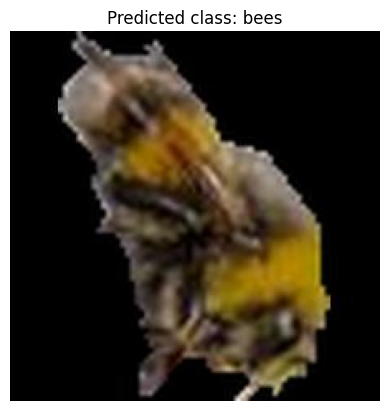

Predicted class for the test image: bees


In [18]:
import os
import numpy as np
import random
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
from PIL import Image
import matplotlib.pyplot as plt

# Path to the SegmentedDataset and the saved model
segmented_data_dir = '/content/SegmentedDataset'
model_path = 'insect_classifier_model_mobilenet.h5'

# Load the saved model
model = load_model(model_path)

# Function to get a random image from the SegmentedDataset
def get_random_image_from_dataset(dataset_dir):
    # Get all the class directories (subfolders)
    class_dirs = [os.path.join(dataset_dir, class_name) for class_name in os.listdir(dataset_dir) if os.path.isdir(os.path.join(dataset_dir, class_name))]

    # Randomly pick a class
    random_class_dir = random.choice(class_dirs)

    # Get all image files in the selected class
    image_files = [f for f in os.listdir(random_class_dir) if f.endswith('.jpg') or f.endswith('.jpeg') or f.endswith('.png')]

    # Randomly pick an image file
    random_image_file = random.choice(image_files)

    # Full path to the randomly selected image
    random_image_path = os.path.join(random_class_dir, random_image_file)

    return random_image_path

# Function to preprocess the image
def preprocess_image(image_path, target_size=(224, 224)):
    img = Image.open(image_path).convert("RGB")  # Load image in RGB format
    img = img.resize(target_size)  # Resize image to the input size expected by the model
    img_array = np.array(img) / 255.0  # Normalize image to [0, 1] range
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    return img_array

# Load a random image from the SegmentedDataset
random_image_path = get_random_image_from_dataset(segmented_data_dir)
print(f"Testing on image: {random_image_path}")

# Preprocess the image
img_array = preprocess_image(random_image_path)

# Make a prediction
prediction = model.predict(img_array)
predicted_label_index = np.argmax(prediction)
class_names = sorted(os.listdir(segmented_data_dir))  # Load class names based on subfolder names
predicted_class = class_names[predicted_label_index]

# Display the image along with the predicted class
img = Image.open(random_image_path)
plt.imshow(img)
plt.title(f"Predicted class: {predicted_class}")
plt.axis('off')
plt.show()

print(f"Predicted class for the test image: {predicted_class}")

90/90 ━━━━━━━━━━━━━━━━━━━━ 6s 39ms/step


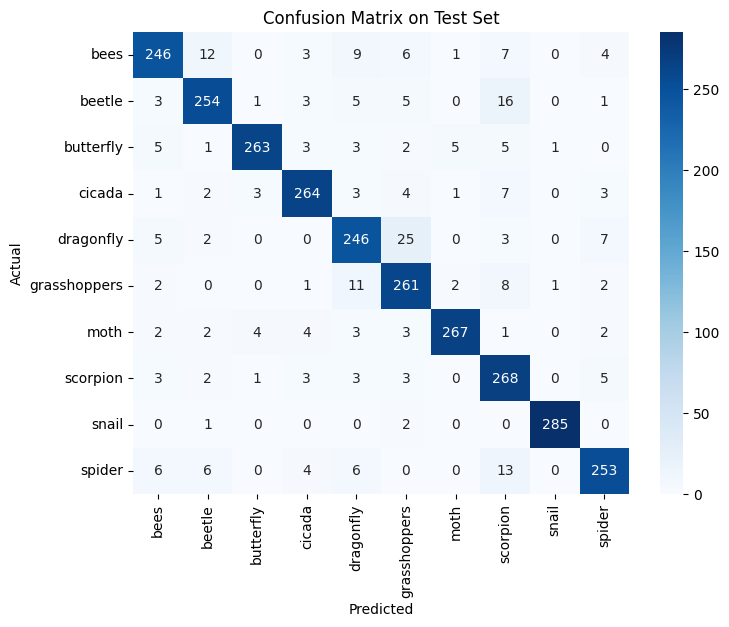

In [19]:
# Generating confusion matrix to see where we are atm
import numpy as np
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# 1) Get predictions (softmax scores → class indices)
y_pred_probs  = model.predict(test_generator, verbose=1)
y_pred_labels = np.argmax(y_pred_probs, axis=1)

# 2) True labels
y_true = test_generator.classes

# 3) Confusion matrix
cm = confusion_matrix(y_true, y_pred_labels)

# 4) Plot
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d',
            xticklabels=test_generator.class_indices.keys(),
            yticklabels=test_generator.class_indices.keys(),
            cmap='Blues')
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix on Test Set")
plt.show()


In [20]:
pip install gradio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.2/54.2 MB 19.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 323.3/323.3 kB 30.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.2/95.2 kB 10.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.5/11.5 MB 131.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.0/72.0 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.4/62.4 kB 6.2 MB/s eta 0:00:00


In [ ]:
import os, numpy as np, random
import tensorflow as tf
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
import gradio as gr

# image size & batch
IMG_SIZE = (224, 224)
BATCH_SIZE = 32

# Path to your segmented dataset
DATA_DIR = '/content/SegmentedDataset'
# Normalize and split the dataset
datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2  # 80% train, 20% test
)

train_gen = datagen.flow_from_directory(
    DATA_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    subset='training',
    shuffle=True
)

test_gen = datagen.flow_from_directory(
    DATA_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    subset='validation',
    shuffle=False
)

class_names = list(train_gen.class_indices.keys())
NUM_CLASSES = len(class_names)
print(f"Classes ({NUM_CLASSES}):", class_names)


Found 15360 images belonging to 10 classes.
Found 3830 images belonging to 10 classes.
Classes (10): ['bees', 'beetle', 'butterfly', 'cicada', 'dragonfly', 'grasshoppers', 'moth', 'scorpion', 'snail', 'spider']


In [22]:
import gradio as gr
import numpy as np
from PIL import Image
from tensorflow.keras.models import load_model

# Constants
IMG_SIZE = (224, 224)

# Load model
model = load_model("insect_classifier_model_mobilenet.h5")

# Define class names
class_names = ['bees', 'beetle', 'butterfly', 'cicada', 'dragonfly',
               'grasshoppers', 'moth', 'scorpion', 'snail', 'spider']
NUM_CLASSES = len(class_names)

# Classification function
def classify_image(image):
    image = image.resize(IMG_SIZE).convert("RGB")
    arr = np.array(image) / 255.0
    arr = np.expand_dims(arr, 0)
    preds = model.predict(arr)[0]
    return {class_names[i]: float(preds[i]) for i in range(NUM_CLASSES)}

# Gradio interface
iface = gr.Interface(
    fn=classify_image,
    inputs=gr.Image(type="pil"),
    outputs=gr.Label(num_top_classes=3),
    title="Insect Classifier",
    description="Upload an insect image to see the top-3 predicted classes.",
)

iface.launch(debug=True)

It looks like you are running Gradio on a hosted a Jupyter notebook. For the Gradio app to work, sharing must be enabled. Automatically setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
* Running on public URL: https://cd4a01a8f9d67e9c11.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Keyboard interruption in main thread... closing server.
Killing tunnel 127.0.0.1:7860 <> https://cd4a01a8f9d67e9c11.gradio.live
